# CNN

In [ ]:
%%shell

unzip archive.zip
mkdir PnPLO_dataset
mv Test PnPLO_dataset/Test
mv Train PnPLO_dataset/Train
mv Val PnPLO_dataset/Val

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import cv2
import os
from xml.etree import ElementTree
from matplotlib import pyplot as plt
# Any results you write to the current directory are saved as output.

In [ ]:
# Ensures any figures or outputs from matplotlib are displayed in the current notebook; mainly used in Jupyter notebooks

%tensorflow_version 2.x  # this line is not required unless you are in a notebook
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from tensorflow.keras import datasets, layers, models
keras = tf.keras

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
# Define the class names and their corresponding labels as a dictionary for easy lookup

class_names = ['person','person-like']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

n_classes = 2
size = (200,200)


In [ ]:
# Function to load data from specified datasets (train, test, validation)
# Each dataset consists of images and corresponding XML annotations.
# The function processes images and labels and returns them in a format suitable for training.

def load_data():
    datasets = ['Train/Train', 'Test/Test', 'Val/Val']
    output = []

    for dataset in datasets:
        imags = []
        labels = []
        directoryA = "PnPLO_dataset/" + dataset +"/Annotations"
        directoryIMG = "PnPLO_dataset/" + dataset +"/JPEGImages/"
        file = os.listdir(directoryA)
        img = os.listdir(directoryIMG)
        file.sort()
        img.sort()

        i = 0
        for xml in file:

            xmlf = os.path.join(directoryA,xml)
            dom = ElementTree.parse(xmlf)
            vb = dom.findall('object')
            label = vb[0].find('name').text
            labels.append(class_names_label[label])

            img_path = directoryIMG + img[i]
            curr_img = cv2.imread(img_path)
            curr_img = cv2.resize(curr_img, size)
            imags.append(curr_img)
            i +=1

        imags = np.array(imags, dtype='float32')
        imags = imags / 255

      #  labels = pd.DataFrame(labels)
        labels = np.array(labels, dtype='int32')

        output.append((imags, labels))
    return output

In [ ]:
# Load the dataset by calling the load_data function, which processes and splits the data into training, testing, and validation sets.

(train_images, train_labels),(test_images, test_labels),(val_images, val_labels) = load_data()

In [ ]:
train_images.shape

(944, 200, 200, 3)

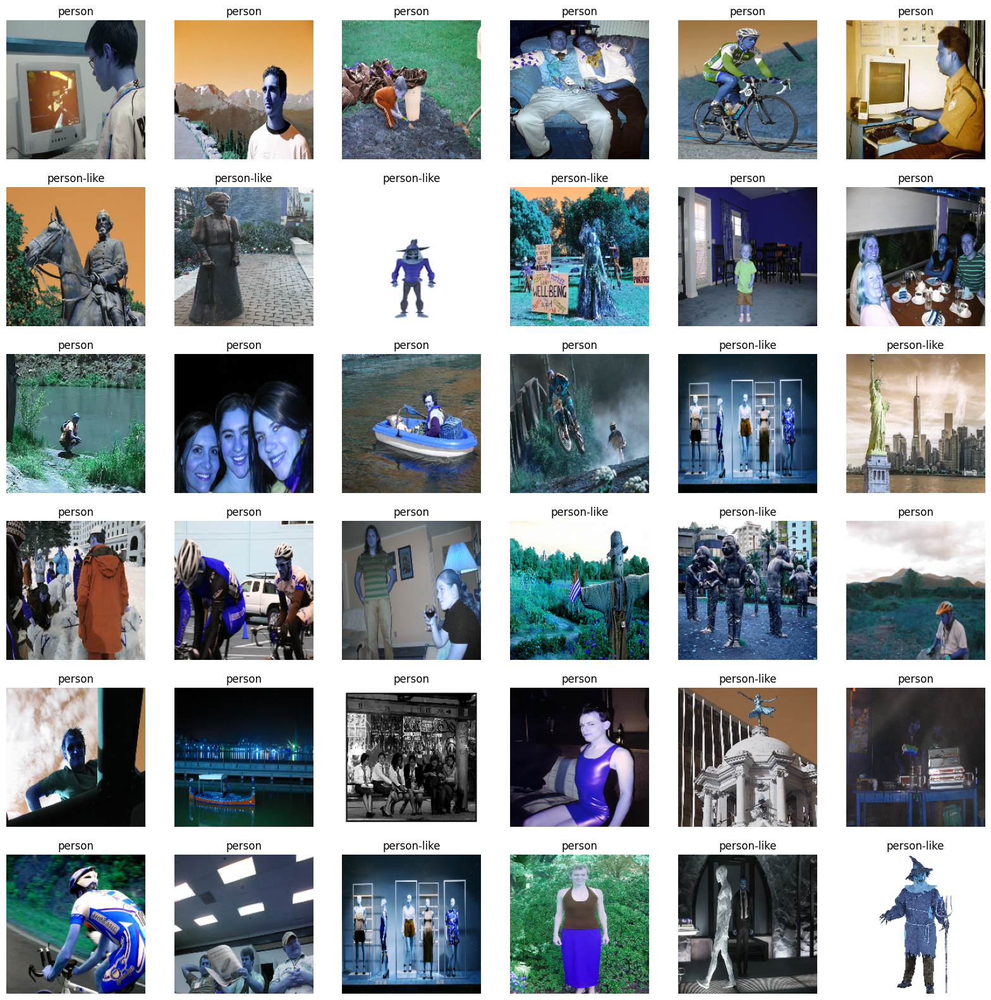

In [ ]:
# Visualize a random sample of 36 images from the training set to verify the data loading process.

plt.figure(figsize=(20,20))
for n , i in enumerate(list(np.random.randint(0,len(train_images),36))) :
    plt.subplot(6,6,n+1)
    plt.imshow(train_images[i])
    plt.title(class_names[train_labels[i]])
    plt.axis('off')

In [ ]:
# Define the architecture of the Convolutional Neural Network (CNN) model for classification.

model = models.Sequential()
model.add(layers.Conv2D(16, (3, 3), activation='relu', input_shape=(200, 200, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(32, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))

In [ ]:
# Flatten the output from 2D to 1D and add dense layers for classification.

model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(2))

In [ ]:
# Compile the model with the Adam optimizer, loss function, and evaluation metric as accuracy.

model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
# Train the CNN model on the training data and validate it using the test data. The history of training is stored for later analysis.

history = model.fit(train_images, train_labels, epochs=6,
                    validation_data=(test_images, test_labels))

Epoch 1/6
30/30 [==============================] - 44s 1s/step - loss: 1.1659 - accuracy: 0.5561 - val_loss: 0.6418 - val_accuracy: 0.6170
Epoch 2/6
30/30 [==============================] - 44s 1s/step - loss: 0.6236 - accuracy: 0.6536 - val_loss: 0.5987 - val_accuracy: 0.7106
Epoch 3/6
30/30 [==============================] - 41s 1s/step - loss: 0.5650 - accuracy: 0.6822 - val_loss: 0.7132 - val_accuracy: 0.5745
Epoch 4/6
30/30 [==============================] - 41s 1s/step - loss: 0.3879 - accuracy: 0.8464 - val_loss: 0.6801 - val_accuracy: 0.6809
Epoch 5/6
30/30 [==============================] - 42s 1s/step - loss: 0.2315 - accuracy: 0.9131 - val_loss: 0.8585 - val_accuracy: 0.6766
Epoch 6/6
30/30 [==============================] - 45s 2s/step - loss: 0.1195 - accuracy: 0.9661 - val_loss: 1.1513 - val_accuracy: 0.6681


In [ ]:
# Function to plot the accuracy and loss for both training and validation sets over epochs.
# This helps in diagnosing issues in the training process, such as overfitting or underfitting.


def plot_accuracy_loss(history):
    """
        Plot the accuracy and the loss during the training of the nn.
    """
    fig = plt.figure(figsize=(10,5))

    # Plot accuracy
    plt.subplot(221)
    plt.plot(history.history['accuracy'],'bo--', label = "acc")
    plt.plot(history.history['val_accuracy'], 'ro--', label = "val_acc")
    plt.title("train_acc vs val_acc")
    plt.ylabel("accuracy")
    plt.xlabel("epochs")
    plt.legend()

    # Plot loss function
    plt.subplot(222)
    plt.plot(history.history['loss'],'bo--', label = "loss")
    plt.plot(history.history['val_loss'], 'ro--', label = "val_loss")
    plt.title("train_loss vs val_loss")
    plt.ylabel("loss")
    plt.xlabel("epochs")

    plt.legend()
    plt.show()

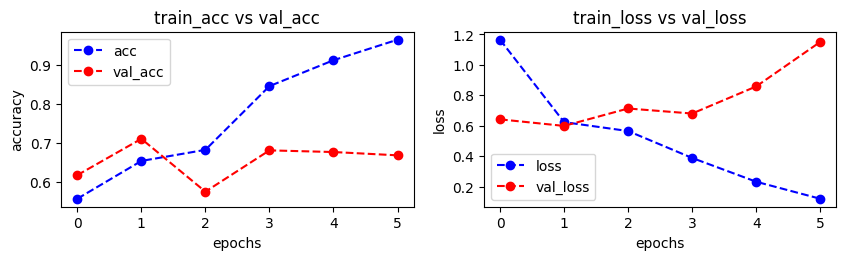

In [ ]:
plot_accuracy_loss(history)

In [ ]:
# Use the trained model to make predictions on the validation images and visualize a random sample of 36 images with their predicted labels.

preds = model.predict(val_images)

5/5 [==============================] - 2s 309ms/step


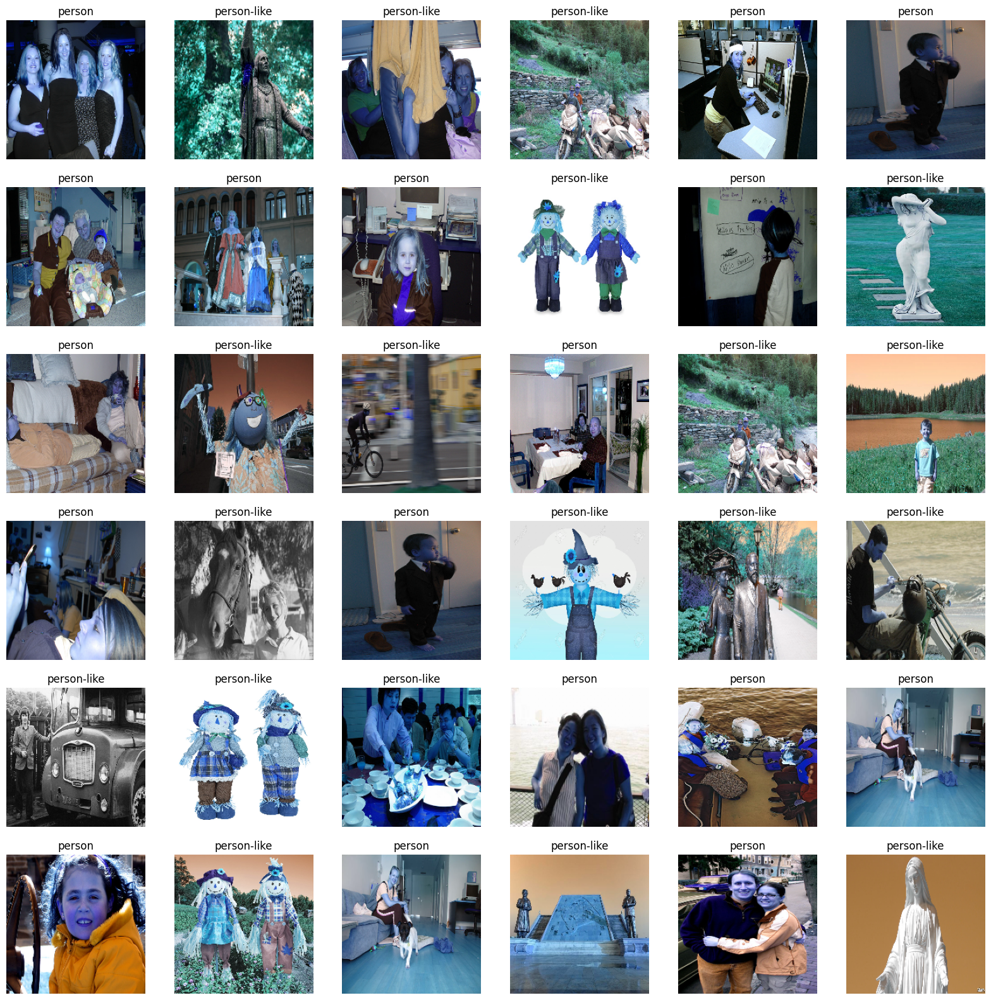

In [ ]:
plt.figure(figsize=(20,20))
for n , i in enumerate(list(np.random.randint(0,len(val_images),36))) :
    plt.subplot(6,6,n+1)
    plt.imshow(val_images[i])
    plt.axis('off')
    x =np.argmax(preds[i]) # takes the maximum of of the 6 probabilites.
    plt.title((class_names[x]))

In [ ]:
# Convert the prediction probabilities into actual class predictions and prepare them for evaluation.

result = []
for i in range(len(preds)):
    result.append(np.argmax(preds[i]))

In [ ]:
# Calculate the confusion matrix components (true negatives, false positives, false negatives, and true positives) to evaluate the model's performance.

tn, fp, fn, tp = confusion_matrix(val_labels,result).ravel()

In [ ]:
(tn, fp, fn, tp)

(54, 31, 10, 65)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# YOLO

In [ ]:
!pip install -q roboflow

In [ ]:
#https://colab.research.google.com/drive/1gDZ2xcTOgR39tGGs-EZ6i3RTs16wmzZQ?usp=sharing

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="sCiEG4D4q6rqh5iTcyJA")
project = rf.workspace().project("pedestrian-detection-wnwek")
model = project.version(1).model

# infer on a local image
# Predicting on a local image using the model and printing the JSON results.
# The 'confidence' and 'overlap' parameters are used to filter predictions
print(model.predict("/content/drive/MyDrive/PnPLO Dataset/Test/JPEGImages/000001.jpg", confidence=40, overlap=30).json())

# visualize your prediction
model.predict("/content/drive/MyDrive/PnPLO Dataset/Test/JPEGImages/000001.jpg", confidence=40, overlap=30).save("/content/prediction.jpg")
model.predict("/content/drive/MyDrive/PnPLO Dataset/Test/JPEGImages/img (182).jpg", confidence=40, overlap=30).save("/content/prediction_2.jpg")



loading Roboflow workspace...
loading Roboflow project...
{'predictions': [{'x': 191.0, 'y': 250.0, 'width': 324.0, 'height': 500.0, 'confidence': 0.9175540208816528, 'class': 'person', 'class_id': 1, 'detection_id': '251c02a5-d2bb-4a83-93d0-817930b2d08d', 'image_path': '/content/drive/MyDrive/PnPLO Dataset/Test/JPEGImages/000001.jpg', 'prediction_type': 'ObjectDetectionModel'}], 'image': {'width': '353', 'height': '500'}}


In [ ]:
!mkdir yolo_predictions

In [ ]:
# ----------------------------------------------------------
# The section below deals with creating a list of randomly selected images
# from a validation dataset for predictions and visualization.

# Importing necessary libraries for random operations and file handling.


import random
import os

# Generate 10 unique random numbers between 0 and 236
random_numbers = random.sample(range(237), 10)
print(random_numbers)
# Directory containing validation images
val_images_dir = '/content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages'

# Model parameters
confidence_threshold = 40
overlap_threshold = 30


# Sort the images by name or some criteria that aligns with indexing
sorted_images = sorted(os.listdir(val_images_dir))

# Loop through the list of sorted images
# Looping through sorted images and predicting on randomly selected ones.
# The results are saved in a specified directory.

for index, image_name in enumerate(sorted_images):
    # Check if the current index is one of the random numbers
    if index in random_numbers:
        # Generate the full path to the image
        image_path = os.path.join(val_images_dir, image_name)

        # Predict using the model
        model.predict(image_path, confidence=confidence_threshold, overlap=overlap_threshold).save(f"/content/yolo_predictions/predict{index}.jpg")
        print(index, image_path)

print("Done")



[24, 2, 93, 5, 161, 134, 125, 232, 138, 100]
2 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/2008_001390.jpg
5 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/2008_001413.jpg
24 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/2008_001525.jpg
93 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/img (19).jpg
100 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/img (25).jpg
125 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/img (48).jpg
134 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/img (56).jpg
138 /content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/img (6).jpg
Done


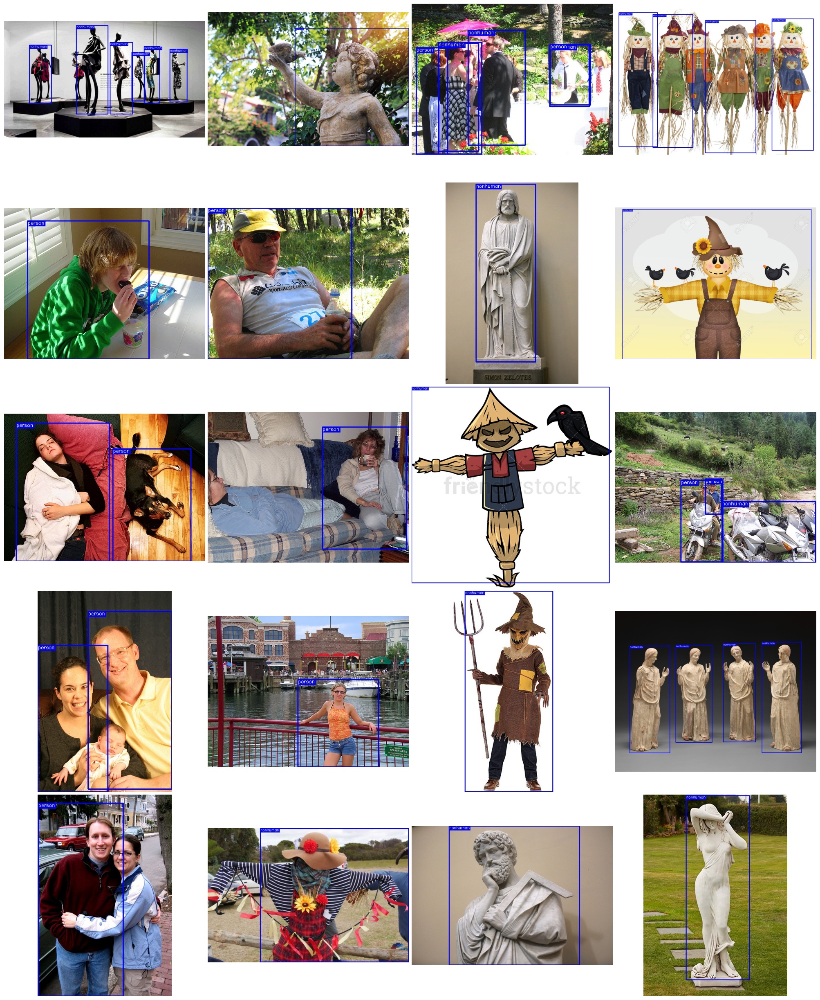

In [ ]:
# ----------------------------------------------------------
# The section below demonstrates how to create a collage of images
# using matplotlib to visualize predictions.

# Importing libraries for image processing and display.


import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import numpy as np


# Function to create a collage of images from a given directory.
# It takes the number of rows and columns as input to structure the collage
def create_collage(directory, rows=5, cols=4):
    # List image files in the directory
    image_files = [os.path.join(directory, f) for f in os.listdir(directory) if f.endswith(('png', 'jpg', 'jpeg'))]

    if not image_files:
        raise ValueError("No images found in the directory.")

    # Set up the figure size based on number of rows and columns
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(cols*5, rows*5))

    # Flatten axes array to make iterating easier
    ax = axes.ravel()

    # Load and plot each image
    for i, img_path in enumerate(image_files[:rows*cols]):
        img = mpimg.imread(img_path)
        ax[i].imshow(img)
        ax[i].axis('off')  # Hide axes

    # Hide unused subplots if there are any
    for j in range(i + 1, rows*cols):
        ax[j].axis('off')

    plt.tight_layout(pad=0.5)
    plt.show()

# Usage example:
directory_path = '/content/yolo_predictions'
create_collage(directory_path)


In [ ]:
# ----------------------------------------------------------
# The section below is focused on initializing the Roboflow model,
# predicting on each image in the dataset, and saving the results.

# Importing libraries for JSON handling and XML parsing.


import os
import json
import xml.etree.ElementTree as ET
from roboflow import Roboflow

# Function to load environment variables containing sensitive data.
def load_environment_variables():
    """ Load sensitive data from environment variables """
    return {
        'rf_api_key': 'sCiEG4D4q6rqh5iTcyJA',
        'project_name': "pedestrian-detection-wnwek",
        'version_number': 1,
        'test_images_dir': '/content/drive/MyDrive/PnPLO Dataset/Test/JPEGImages/',
        'val_images_dir': '/content/drive/MyDrive/PnPLO Dataset/Val/JPEGImages/',
        'val_annotations_dir': '/content/drive/MyDrive/PnPLO Dataset/Test/Annotations'
    }
# Function to initialize Roboflow with the provided API key.
def initialize_roboflow(api_key):
    """ Initialize Roboflow instance """
    if not api_key:
        raise ValueError("API Key for Roboflow is missing. Please set the ROBOFLOW_API_KEY environment variable.")
    rf = Roboflow(api_key=api_key)
    return rf.workspace().project(env_vars['project_name']).version(env_vars['version_number']).model

# Function to predict on each image in the directory and save the results
def predict_and_save_results(model, images_dir, output_filename):
    """ Run prediction on each image in the dataset and save the results """
    if not os.path.exists(images_dir):
        raise FileNotFoundError(f"The directory {images_dir} does not exist.")

    roboflow_results = {}
    try:
        for image_name in os.listdir(images_dir):
            image_path = os.path.join(images_dir, image_name)
            result = model.predict(image_path, confidence=80, overlap=40).json()
            roboflow_results[image_name] = result
    except Exception as e:
        print(f"An error occurred during prediction: {e}")

    # Save results to a file
    try:
        with open(output_filename, 'w') as fp:
            json.dump(roboflow_results, fp)
    except IOError as e:
        print(f"An error occurred while writing to file: {e}")

# Function to convert Roboflow predictions to XML format
def convert_predictions_to_xml_format(predictions):
    """ Convert Roboflow bounding box predictions to XML format """
    converted_predictions = {}
    for image_id, data in predictions.items():
        converted_bboxes = []
        for pred in data['predictions']:
            # Convert the center coordinates back to xmin, ymin, xmax, ymax
            xmin = pred['x'] - (pred['width'] / 2)
            ymin = pred['y'] - (pred['height'] / 2)
            xmax = pred['x'] + (pred['width'] / 2)
            ymax = pred['y'] + (pred['height'] / 2)
            converted_bboxes.append({
                'label': pred['class'],
                'bbox': (xmin, ymin, xmax, ymax),
                'confidence': pred['confidence']
            })
        converted_predictions[image_id.replace('.jpg', '.xml')] = converted_bboxes
    return converted_predictions

# Main execution starts here
if __name__ == '__main__':
    env_vars = load_environment_variables()
    model = initialize_roboflow(env_vars['rf_api_key'])
    predict_and_save_results(model, env_vars['val_images_dir'], 'roboflow_results_val.json')
    predict_and_save_results(model, env_vars['test_images_dir'], 'roboflow_results.json')


loading Roboflow workspace...
loading Roboflow project...


In [ ]:
# ----------------------------------------------------------
# The section below shows how to parse XML annotations to extract ground truths,
# calculate Intersection over Union (IoU) between predicted and actual bounding boxes,
# and load prediction results for further analysis.


import xml.etree.ElementTree as ET

def parse_xml_annotation(file_path):
    """
    Parse an XML file and return a list of ground truth bounding boxes and labels
    """
    tree = ET.parse(file_path)
    root = tree.getroot()
    ground_truths = []

    for member in root.findall('object'):
        label = member.find('name').text
        bndbox = member.find('bndbox')
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)

        # Convert (xmin, ymin, xmax, ymax) to (x_center, y_center, width, height)
        x_center = (xmin + xmax) / 2
        y_center = (ymin + ymax) / 2
        width = xmax - xmin
        height = ymax - ymin

        ground_truths.append({'label': label, 'bbox': (x_center, y_center, width, height)})

    return ground_truths


In [ ]:
ground_truths = {}
val_annotations_dir = '/content/drive/MyDrive/PnPLO Dataset/Test/Annotations'
for annotation_file in os.listdir(val_annotations_dir):
    annotation_path = os.path.join(val_annotations_dir, annotation_file)
    if os.path.isfile(annotation_path):  # Check if it's a file
        ground_truths[annotation_file] = parse_xml_annotation(annotation_path)

In [ ]:
print(ground_truths)

{'000001.xml': [{'label': 'person', 'bbox': (180.0, 255.0, 344, 486)}], '000038.xml': [{'label': 'person', 'bbox': (226.5, 175.5, 69, 129)}], '000025.xml': [{'label': 'person', 'bbox': (408.0, 188.5, 176, 373)}, {'label': 'person', 'bbox': (281.0, 189.0, 120, 370)}, {'label': 'person', 'bbox': (177.5, 81.0, 85, 134)}, {'label': 'person', 'bbox': (81.0, 96.5, 46, 85)}, {'label': 'person', 'bbox': (305.0, 43.5, 52, 85)}, {'label': 'person', 'bbox': (332.0, 59.0, 24, 74)}], '000010.xml': [{'label': 'person', 'bbox': (189.0, 178.0, 112, 212)}], '000022.xml': [{'label': 'person', 'bbox': (220.5, 137.0, 69, 186)}], '000043.xml': [{'label': 'person', 'bbox': (249.0, 302.0, 150, 146)}, {'label': 'person', 'bbox': (127.5, 322.5, 245, 355)}, {'label': 'person', 'bbox': (171.0, 253.0, 304, 494)}], '000027.xml': [{'label': 'person', 'bbox': (261.5, 226.0, 175, 250)}], '000058.xml': [{'label': 'person', 'bbox': (385.0, 187.0, 102, 372)}, {'label': 'person', 'bbox': (252.5, 203.0, 113, 246)}, {'labe

In [ ]:
# Importing JSON for file handling.

import json

def bb_intersection_over_union(boxA, boxB):
    # Determine the coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[0] + boxA[2], boxB[0] + boxB[2])
    yB = min(boxA[1] + boxA[3], boxB[1] + boxB[3])

    # Calculate the area of the intersection rectangle
    interArea = max(0, xB - xA) * max(0, yB - yA)

    # Calculate the area of both the prediction and ground-truth rectangles
    boxAArea = boxA[2] * boxA[3]
    boxBArea = boxB[2] * boxB[3]

    # Compute the intersection over union
    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

# Load the updated predictions JSON
with open('/content/roboflow_results.json', 'r') as file:
    updated_predictions_data = json.load(file)

# List to store all IoUs
updated_ious = []

# Metrics initialization
updated_true_positives = 0
updated_false_positives = 0
updated_false_negatives = 0

iou_threshold = 0.5  # Set the IoU threshold

# Analysis
for image_id, gt_bboxes in ground_truths.items():
    image_jpg_id = image_id.replace('.xml', '.jpg')
    if image_jpg_id in updated_predictions_data:
        updated_pred_bboxes = updated_predictions_data[image_jpg_id]['predictions']
        for gt_bbox_info in gt_bboxes:
            gt_bbox = tuple(gt_bbox_info['bbox'])
            matched = False
            for updated_pred_bbox_info in updated_pred_bboxes:
                updated_pred_bbox = (updated_pred_bbox_info['x'], updated_pred_bbox_info['y'],
                                     updated_pred_bbox_info['width'], updated_pred_bbox_info['height'])
                updated_iou = bb_intersection_over_union(gt_bbox, updated_pred_bbox)
                updated_ious.append(updated_iou)
                if updated_iou >= iou_threshold and gt_bbox_info['label'] == updated_pred_bbox_info['class']:
                    matched = True
                    updated_true_positives += 1
                    break
            if not matched:
                updated_false_negatives += 1
    else:
        updated_false_negatives += len(gt_bboxes)

# Calculating false positives
updated_false_positives = sum(len(data['predictions']) for data in updated_predictions_data.values()) - updated_true_positives

# Calculate precision and recall
updated_precision = updated_true_positives / (updated_true_positives + updated_false_positives) if updated_true_positives + updated_false_positives > 0 else 0
updated_recall = updated_true_positives / (updated_true_positives + updated_false_negatives) if updated_true_positives + updated_false_negatives > 0 else 0

# Print the results
print(f"Precision: {updated_precision}")
print(f"Recall: {updated_recall}")
print(f"Average IoU: {sum(updated_ious) / len(updated_ious) if updated_ious else 0}")


Precision: 0.9043478260869565
Recall: 0.3495798319327731
Average IoU: 0.27816544658206116


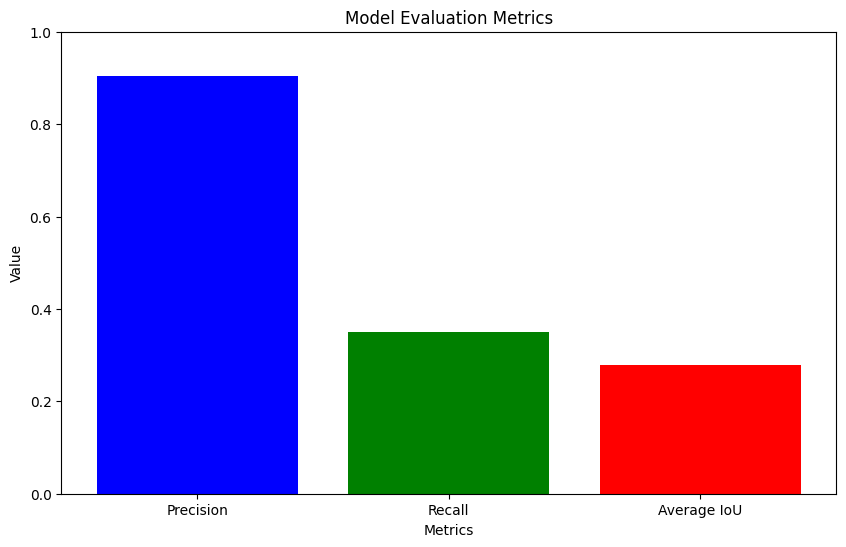

In [ ]:
# Function to plot the evaluation metrics for visual representation of model performance.


def plot_evaluation_metrics(precision, recall, average_iou):
    """
    Plot the precision, recall, and average IoU as bar graphs.

    :param precision: Precision of the model.
    :param recall: Recall of the model.
    :param average_iou: Average Intersection over Union of the model.
    """
    metrics = ['Precision', 'Recall', 'Average IoU']
    values = [precision, recall, average_iou]

    plt.figure(figsize=(10, 6))
    plt.bar(metrics, values, color=['blue', 'green', 'red'])
    plt.xlabel('Metrics')
    plt.ylabel('Value')
    plt.title('Model Evaluation Metrics')
    plt.ylim(0, 1)  # Assuming precision, recall, and IoU are normalized between 0 and 1
    plt.show()

plot_evaluation_metrics(updated_precision, updated_recall, sum(updated_ious) / len(updated_ious) if updated_ious else 0)


# SSD

In [ ]:
!pip install imageai opencv-python tensorflow

  Using cached imageai-3.0.3-py3-none-any.whl (69 kB)


In [ ]:
# ----------------------------------------------------------
# The section below is related to the ImageAI library, which is used for object detection.
# The code demonstrates how to set up the detector, load a pre-trained model, and detect objects in an image.

# Importing the ObjectDetection class from the ImageAI library.


from imageai.Detection import ObjectDetection
import os

execution_path = os.getcwd()

detector = ObjectDetection()
detector.setModelTypeAsRetinaNet()
detector.setModelPath(os.path.join(execution_path, "RetinaNet ResNet50 FPN COCO.pth"))
detector.loadModel()

custom = detector.CustomObjects(person=True)
# Running the object detection on an image and saving the result with custom settings.
detections = detector.detectObjectsFromImage(
    custom_objects=custom,
    input_image=os.path.join(execution_path, "drive/MyDrive/PnPLO Dataset/Test/JPEGImages/000001.jpg"),
    output_image_path=os.path.join(execution_path, "image3new-custom.jpg"),
    minimum_percentage_probability=30
)


In [ ]:
# Setting up the object detection model and specifying the model path.

execution_path = os.getcwd()
print(execution_path)

/content


In [ ]:
from imageai.Detection import ObjectDetection
import os
import xml.etree.ElementTree as ET

# Assuming that the XML files follow the PASCAL VOC format
def parse_annotation(annotation_path):
    tree = ET.parse(annotation_path)
    root = tree.getroot()
    objects = []
    for obj in root.findall('object'):
        obj_struct = {}
        obj_struct['name'] = obj.find('name').text
        bbox = obj.find('bndbox')
        obj_struct['bbox'] = [int(bbox.find('xmin').text),
                              int(bbox.find('ymin').text),
                              int(bbox.find('xmax').text),
                              int(bbox.find('ymax').text)]
        objects.append(obj_struct)
    return objects

# Function to calculate IoU (Intersection over Union)
def calculate_iou(gt_bbox, pred_bbox):
    '''
    Calculate the Intersection over Union (IoU) of two bounding boxes.
    '''
    x1_gt, y1_gt, x2_gt, y2_gt = gt_bbox
    x1_pred, y1_pred, x2_pred, y2_pred = pred_bbox

    x1_inter = max(x1_gt, x1_pred)
    y1_inter = max(y1_gt, y1_pred)
    x2_inter = min(x2_gt, x2_pred)
    y2_inter = min(y2_gt, y2_pred)

    width_inter = max(0, x2_inter - x1_inter)
    height_inter = max(0, y2_inter - y1_inter)

    area_inter = width_inter * height_inter
    area_gt = (x2_gt - x1_gt) * (y2_gt - y1_gt)
    area_pred = (x2_pred - x1_pred) * (y2_pred - y1_pred)

    area_union = area_gt + area_pred - area_inter

    if area_union == 0:
        return 0
    return area_inter / area_union

# Function to calculate evaluation metrics
def calculate_metrics(detections, ground_truths):
    '''
    Calculate the true positives, false positives, false negatives, precision, recall, and F1 score.
    '''
    iou_threshold = 0.5
    true_positives = 0
    false_positives = 0
    false_negatives = len(ground_truths)

    for detection in detections:
        pred_bbox = detection['box_points']
        for gt in ground_truths:
            gt_bbox = gt['bbox']
            iou = calculate_iou(gt_bbox, pred_bbox)
            if iou >= iou_threshold:
                true_positives += 1
                false_negatives -= 1
                break
        else:
            false_positives += 1

    precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
    recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    return true_positives, false_positives, false_negatives, precision, recall, f1_score

# Main function to run detection and evaluation
def run_evaluation():
    execution_path = os.getcwd()
    image_dir = os.path.join(execution_path, "drive/MyDrive/PnPLO Dataset/Test/JPEGImages")
    annotation_dir = os.path.join(execution_path, "drive/MyDrive/PnPLO Dataset/Test/Annotations")

    # Load the model
    detector = ObjectDetection()
    detector.setModelTypeAsRetinaNet()
    detector.setModelPath(os.path.join(execution_path, "RetinaNet ResNet50 FPN COCO.pth"))
    detector.loadModel()

    custom = detector.CustomObjects(person=True)

    # Evaluation metrics
    total_true_positives = 0
    total_false_positives = 0
    total_false_negatives = 0

    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        detections = detector.detectObjectsFromImage(
            custom_objects=custom,
            input_image=image_path,
            output_image_path=os.path.join(execution_path, "output", image_file),
            minimum_percentage_probability=30
        )

        annotation_file = image_file.replace('.jpg', '.xml')
        annotation_path = os.path.join(annotation_dir, annotation_file)
        ground_truths = parse_annotation(annotation_path)

        tp, fp, fn, precision, recall, f1_score = calculate_metrics(detections, ground_truths)
        total_true_positives += tp
        total_false_positives += fp
        total_false_negatives += fn

    # Calculate overall metrics
    overall_precision = total_true_positives / (total_true_positives + total_false_positives) if (total_true_positives + total_false_positives) > 0 else 0
    overall_recall = total_true_positives / (total_true_positives + total_false_negatives) if (total_true_positives + total_false_negatives) > 0 else 0
    overall_f1_score = 2 * (overall_precision * overall_recall) / (overall_precision + overall_recall) if (overall_precision + overall_recall) > 0 else 0

    print(f"Overall Precision: {overall_precision}")
    print(f"Overall Recall: {overall_recall}")
    print(f"Overall F1 Score: {overall_f1_score}")

# Run the evaluation
run_evaluation()


Overall Precision: 0.8690702087286527
Overall Recall: 0.7697478991596639
Overall F1 Score: 0.8163992869875222


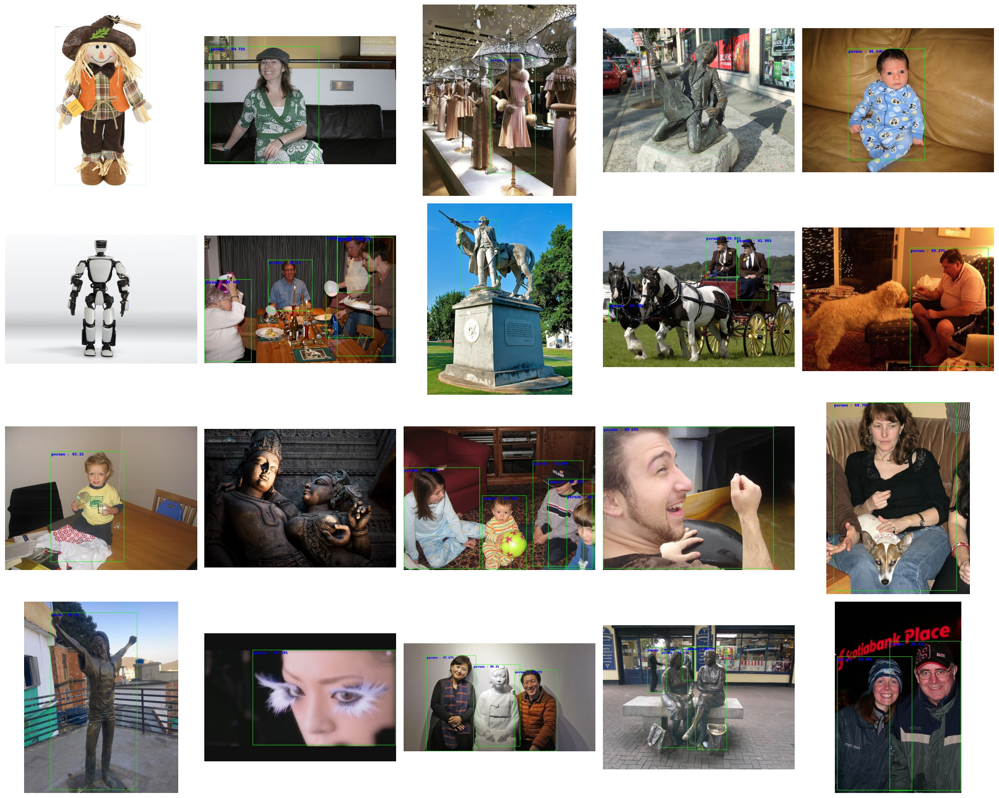

In [ ]:
import os
import random
from imageai.Detection import ObjectDetection
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Initialize the object detection model
execution_path = os.getcwd()
detector = ObjectDetection()
detector.setModelTypeAsRetinaNet()
detector.setModelPath(os.path.join(execution_path, "RetinaNet ResNet50 FPN COCO.pth"))
detector.loadModel()
custom = detector.CustomObjects(person=True)

# Function to process images and create a collage
def process_and_collage(image_dir, output_dir, num_images=20):
    image_files = os.listdir(image_dir)
    random.shuffle(image_files)  # Shuffle to get random images
    images_processed = 0

    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)

    # Create a figure for the collage
    fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(20, 16))  # Adjust subplot grid as needed
    axs = axs.flatten()  # Flatten the array for easy iteration

    for image_file in image_files:
        if images_processed >= num_images:
            break
        input_image_path = os.path.join(image_dir, image_file)
        output_image_path = os.path.join(output_dir, image_file)

        # Perform detection
        detector.detectObjectsFromImage(
            custom_objects=custom,
            input_image=input_image_path,
            output_image_path=output_image_path,
            minimum_percentage_probability=30
        )

        # Load image for collage
        img = mpimg.imread(output_image_path)
        axs[images_processed].imshow(img)
        axs[images_processed].axis('off')  # Hide axes
        images_processed += 1

    # Adjust the layout
    plt.tight_layout()
    plt.show()

# Example usage
image_dir = os.path.join(execution_path, "drive/MyDrive/PnPLO Dataset/Test/JPEGImages")
output_dir = os.path.join(execution_path, "output_images")
process_and_collage(image_dir, output_dir)


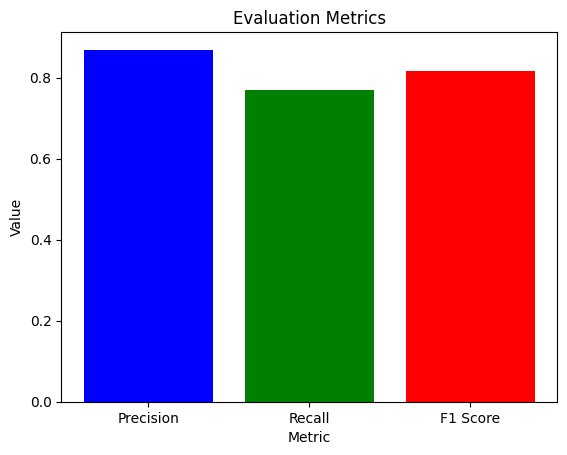

<Figure size 1000x600 with 0 Axes>

In [ ]:
# ----------------------------------------------------------
# This final plotting section provides a simple visualization of the evaluation metrics
# using a bar chart to compare precision, recall, and F1 score.

# Plotting the evaluation metrics on a bar chart for visual comparison.


    # Plotting
    metrics = ['Precision', 'Recall', 'F1 Score']
    values = [0.8690702087286527, 0.7697478991596639, 0.8163992869875222]

    plt.bar(metrics, values, color=['blue', 'green', 'red'])
    plt.xlabel('Metric')
    plt.ylabel('Value')
    plt.title('Evaluation Metrics')

    plt.figure(figsize=(10, 6))
    plt.show()